# Exploratory Data Analysis

## 1) Data Import

### Importing the libraries necessary for data analysis and visualization

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

### Load the datasets from Excel files into pandas DataFrames

In [2]:
# Import the survey data for implementers
data_implemeters = pd.read_excel('Implementadores Survey4.xlsx')
# Import the survey data for users
data_users = pd.read_excel('Survey Users4.xlsx')

### Information about data: get an overview of the datasets, such as column data types and non-null counts

In [3]:
# Display the structure and overview information of implementer data.
data_implemeters.info()
# Display the structure and overview information of user data
data_users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17 entries, 0 to 16
Data columns (total 21 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Timestamp                           17 non-null     float64
 1   Industry                            17 non-null     object 
 2   Region                              17 non-null     object 
 3   Company size                        17 non-null     int64  
 4   Company                             17 non-null     object 
 5   Role                                17 non-null     object 
 6   Projects Involved                   17 non-null     object 
 7   Process Selection                   17 non-null     object 
 8   Benefits Justification              17 non-null     object 
 9   Cost Consideration                  17 non-null     int64  
 10  Data Quality Rating                 17 non-null     int64  
 11  Data Quality                        17 non-null

### Data view snippets: show the first few rows of the datasets for a quick preview

In [4]:
# Display the first five rows of implementer data for a preview
data_implemeters.head()

,Timestamp,Industry,Region,Company size,Company,Role,Projects Involved,Process Selection,Benefits Justification,Cost Consideration,...,Data Quality,Compliance,Integration Challenges,Organizational Culture,Organizational Culture.1,Change Management,Insights Utilization,Skill Gaps,Strategies to cope with Skill Gaps,Celonis Products Used
0,45373.824334,"Retail, Public Sector, Oil and Gas, Manufacturing",Madrid,3000,Celonis,Solution engineer,11-20,"Industry-specific, High-transaction processes","Value tests, SAP data analysis, KPIs, cost sav...",5,...,"Good, Best for large systems, Issues in satell...","Non-personal data analysis, grouped data","Multiple systems, Custom integrations","Moderate receptiveness, Team creation for proc...",3,"Empowerment, Early involvement",Aligning with business cases,5,Continuous training suggested,"Process Mining, Business Miner"
1,45376.017371,"Pharmaceutical, Healthcare",Madrid,3000,Celonis,Demo Engineer,11-20,Client improvement goals,Using Transformation Hub for real vs expected ...,4,...,Inter-departmental data collection issues,High-security standards,"Multiple systems, Technical structure understa...","Moderate receptiveness, Team creation for proc...",3,"Custom dashboards, Metric verification, Iterat...",Continuous personalized training,2,Continuous training suggested,Object Centric Process Mining
2,45381.664073,Supermarket chain,Barcelona,600,Roboyo,Automation Engineer,1-5,Business analysis for logistics,No Data,2,...,"Data fragmentation, Lack of master data manage...",No Data,Minimal,Learning visibility of data,4,Iterative feedback,Creation of dashboards,5,Need for conceptual training,No Data
3,45383.437500,"Manufacturing, Automotive",Amesterdam,200,Appolix,IT Director,1-5,"Audit of resource-intensive, high variability ...","ROI from industry benchmarks, performance metr...",4,...,"Data fragmentation, Inconsistent data practices","GDPR compliance, Data anonymization",Legacy system compatibility,Moderate receptiveness,3,Stakeholder engagement,Creation of dashboards,4,Recommendation for data science training,Celonis EMS
4,45383.583333,"Pharmaceutical, Automotive",Madrid,3000,Celonis,Project Manager,11-20,"Weighted scoring system, Complexity, efficienc...","Pilot projects, KPIs, Like cycle time, Error r...",4,...,"Disparate sources, Unstandardized formats","Compliance training, Data anonymization","Legacy system compatibility, Varying data stan...","Highly responsive, Proactive workshops",4,Gradual implementation roadmap,Continuous personalized training,4,Upskilling programs recommended,Celonis EMS


In [5]:
# Display the first five rows of user data for a preview
data_users.head()

,Timestamp,Industry,Region,Company size,Usage Frequency,Role Utilization,Impact,Skill Gaps,Training Provided,Improvement Example,Suggestions,System Integration,Cultural Impact,Beneficial Features,Feedback
0,45295.468750,Retail,Madrid,5000,Daily,Industry,4,Yes,"Workshops, Ongoing Support","Restocking Protocol, 20% reduction in stockouts",Enhanced forecasting integration,Well with ERP,"Supportive, Forward-thinking","Real-time visualization, Process tracking",More intuitive interface
1,45295.510417,Retail,Madrid,5000,Daily,"Inventory Management, Demand Forecast",4,Initially,Trainings,20% reduction in overstock,"Inventory level forecasting, Enhanced forecast...",Well with ERP,"Supportive, Integral to workflow",Stock discrepancy identification,Simplify interface
2,45355.354861,No Data,Madrid,3000,Daily,"Sales Pipeline Management, Customer Engagement",5,Yes,"Trainings, Celonis Accademy",20% increase in conversions,Better CRM integration,Good with CRM,"Supportive, Innovative","Complex sales process visualization, Real-time...",CRM-specific functionalities
3,45477.611111,Finance,Madrid,500,Daily,Regulatory Compliance Monitoring,5,No,Trainings,30% reduction in error rates,Tailored compliance features,Well with financial systems,"Supportive, Strong management support","Transaction flow overview, Process tracking",Customization for compliance mapping
4,45477.758333,Retail,Madrid,5000,Weekly,Supply Chain Efficiency Tracking,4,Yes,Workshops,15% improvement in delivery times,Deeper logistics software integration,Improvements needed,Data-driven approach encouraged,"Real-time reporting, Real-time visualization",More customized reporting options


### Check for null data: determine the number of missing values in each column

In [6]:
# Calculate the number of missing values in each column of implementer data
data_implemeters.isnull().sum()

Timestamp                             0
Industry                              0
Region                                0
Company size                          0
Company                               0
Role                                  0
Projects Involved                     0
Process Selection                     0
Benefits Justification                0
Cost Consideration                    0
Data Quality Rating                   0
Data Quality                          0
Compliance                            0
Integration Challenges                0
Organizational Culture                0
Organizational Culture.1              0
Change Management                     0
Insights Utilization                  0
Skill Gaps                            0
Strategies to cope with Skill Gaps    0
Celonis Products Used                 0
dtype: int64

In [7]:
# Calculate the number of missing values in each column of user data
data_users.isnull().sum()

Timestamp              0
Industry               0
Region                 0
Company size           0
Usage Frequency        0
Role Utilization       0
Impact                 0
Skill Gaps             0
Training Provided      0
Improvement Example    0
Suggestions            0
System Integration     0
Cultural Impact        0
Beneficial Features    0
Feedback               0
dtype: int64

In [8]:
# Since we have no missing data we won't have to take care of that in the data cleaning part below. We do however want to take care of the multicategory entries.

## 2) Data Cleaning and Preprocessing

### Edit columns with multicategory entries for Implementers

In [9]:
# Define a function to split multicategory entries and tally each unique entry for implementers
def tally_implementer_entries(df, cols):
    tally = {}
    for col in cols:
        # Split the entries on commas and strip whitespace
        split_entries = df[col].str.split(',').apply(lambda x: [item.strip() for item in x if item.strip() != ''])
        # Explode the list into individual items and count them
        exploded_series = split_entries.explode()
        # Save the counts to a dictionary
        tally[col] = exploded_series.value_counts()
    return tally

# List of columns to tally for implementers (categorical variables)
implementer_cols_to_tally = [
    'Industry', 'Process Selection', 'Benefits Justification',
    'Data Quality', 'Compliance', 'Integration Challenges',
    'Organizational Culture', 'Change Management',
    'Insights Utilization', 'Celonis Products Used'
]

# Apply the tally function to the implementer data and print the results
implementer_tally = tally_implementer_entries(data_implemeters, implementer_cols_to_tally)
for col, tally_count in implementer_tally.items():
    print(f"Tally for {col}:")
    print(tally_count)
    print()


Tally for Industry:
Industry
Manufacturing        7
Healthcare           4
Finance              4
Retail               3
Public Sector        2
Pharmaceutical       2
Automotive           2
Diverse              2
Oil and Gas          1
Supermarket chain    1
High Tech            1
Logistics            1
Banking              1
Supply Chain         1
Name: count, dtype: int64

Tally for Process Selection:
Process Selection
Efficiency-impacting processes     5
Digital maturity assessment        3
Complexity                         3
Volume                             2
efficiency-impacting processes     2
High-transaction processes         2
Repetitive                         1
Regulatory processes               1
Customer-facing                    1
High-ROI processes                 1
error-prone processes              1
Industry-specific                  1
Weighted scoring system            1
high variability processes         1
Audit of resource-intensive        1
Business analysis fo

### Edit columns with multicategory entries for Users: same process as above but for user data

In [10]:
# Define a function to count multicategory entries for users
def count_user_entries(df, cols):
    counts = {}
    for col in cols:
        # Split and strip entries just like for implementers
        split_entries = df[col].str.split(',').apply(lambda x: [item.strip() for item in x if item.strip() != ''])
        # Explode the list into individual items and count them
        exploded_series = split_entries.explode()
        # Save the counts to a dictionary
        counts[col] = exploded_series.value_counts()
    return counts

# List of columns to count for users (categorical variables)
user_cols_to_count = [
    'Role Utilization', 'Training Provided', 'Improvement Example',
    'Suggestions', 'System Integration', 'Cultural Impact',
    'Beneficial Features'
]

# Apply the count function to the user data and print the results
user_category_counts = count_user_entries(data_users, user_cols_to_count)
for col, count_data in user_category_counts.items():
    print(f"Counts for User {col}:")
    print(count_data)
    print()


Counts for User Role Utilization:
Role Utilization
Industry                                                 1
Inventory Management                                     1
Demand Forecast                                          1
Sales Pipeline Management                                1
Customer Engagement                                      1
Regulatory Compliance Monitoring                         1
Supply Chain Efficiency Tracking                         1
Monitoring Product Quality                               1
Identifying Failure Points                               1
Customer Success Tracking                                1
Optimizing Account Management                            1
Identifying Upselling and Cross-Selling Opportunities    1
Name: count, dtype: int64

Counts for User Training Provided:
Training Provided
Trainings           4
Workshops           2
Ongoing Support     1
Celonis Accademy    1
Trainngs            1
No Data             1
Name: count, dtype: int64

Co

## 3) Bivariate Analysis

In [11]:
# Helper function to explode multicategory columns into a normalized form
def explode_multicategory(df, col):
    """Explodes multicategory entries in a DataFrame column into separate rows"""
    return (
        df.drop(col, axis=1)
        .join(
            df[col]
            .str.split(',', expand=True)
            .stack()
            .reset_index(level=1, drop=True)
            .rename(col)
        )
    )

In [12]:
multicategory_columns_implementers = ['Industry', 'Process Selection', 'Benefits Justification',
                         'Data Quality', 'Compliance', 'Integration Challenges',
                         'Organizational Culture', 'Change Management',
                         'Insights Utilization', 'Celonis Products Used']
numerical_columns_implementers = ['Skill Gaps', 'Company size', 'Cost Consideration', 'Data Quality Rating', 'Organizational Culture.1']


### Bivariate Analysis for Implementers Categorical and Numerical: analyze relationships between pairs of categorical and numerical variables

In [13]:
#Function to analyze bivariate relationships between categorical and numerical columns
def bivariate_categorical_analysis(df, multicategory_columns, numerical_columns):
    for col in multicategory_columns:
        exploded_df = explode_multicategory(df, col).dropna(subset=[col])
        exploded_df[col] = exploded_df[col].str.strip() # Remove any leading/trailing whitespace

        for num_col in numerical_columns:
            # Calculate the mean of the numerical columns for each category
            means = exploded_df.groupby(col)[num_col].mean().sort_values()
            means.plot(kind='bar', figsize=(10, 5))
            plt.title(f'Mean {num_col} by {col}')
            plt.ylabel(f'Mean {num_col}')
            plt.xticks(rotation=90)
            plt.show()


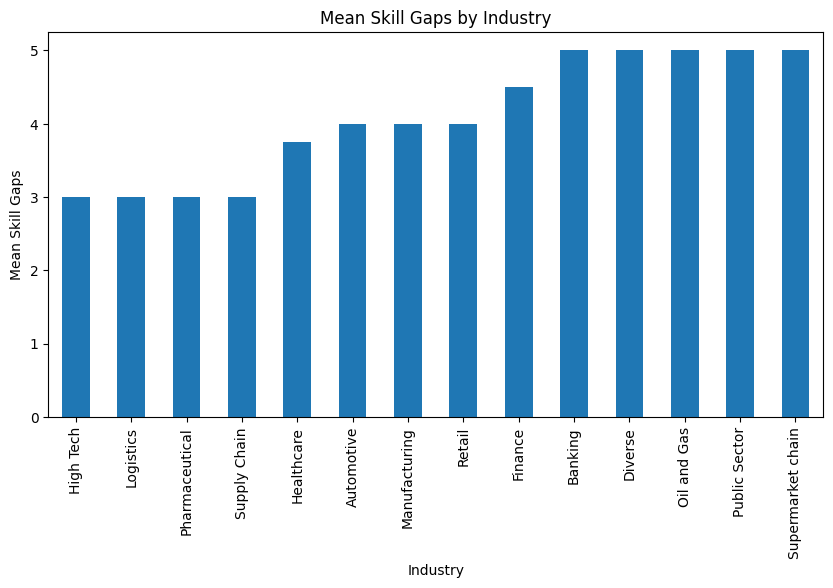

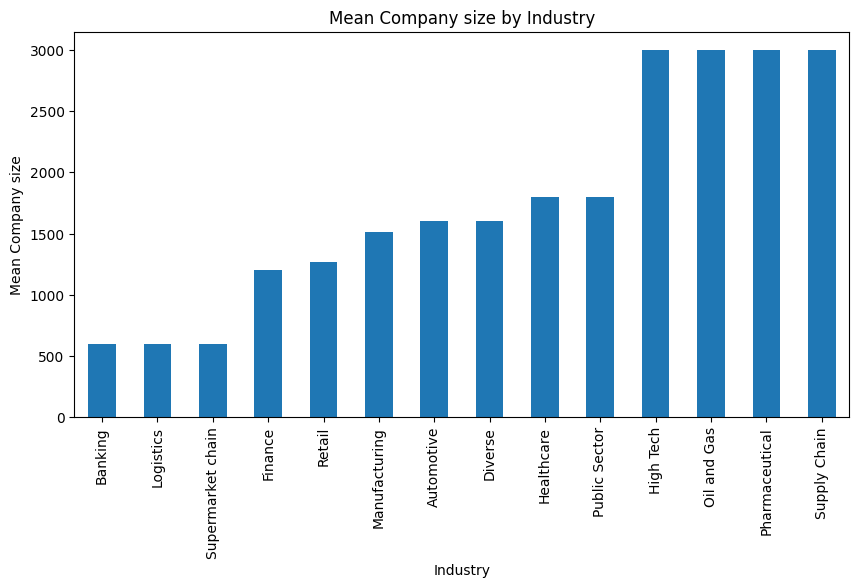

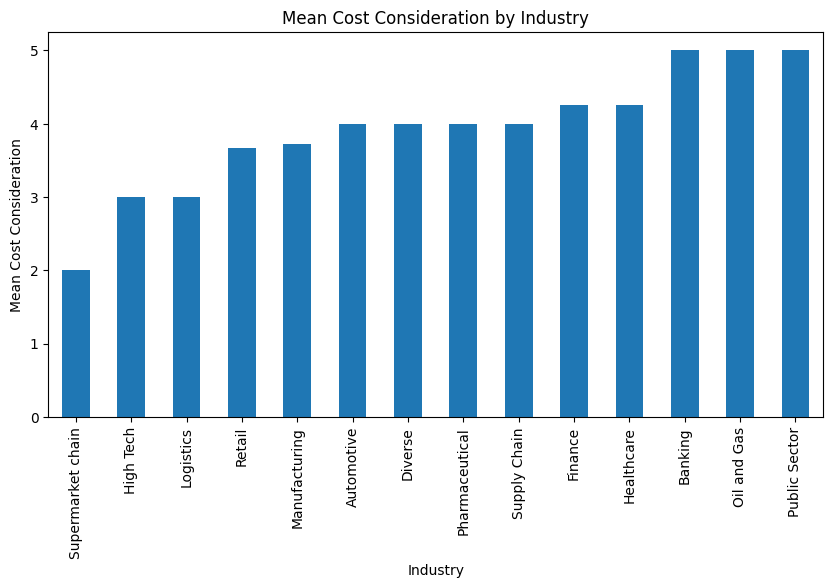

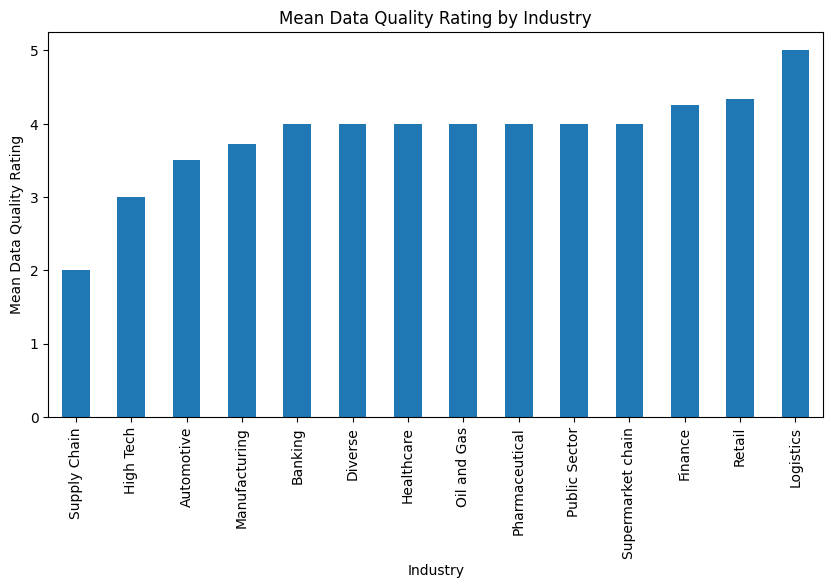

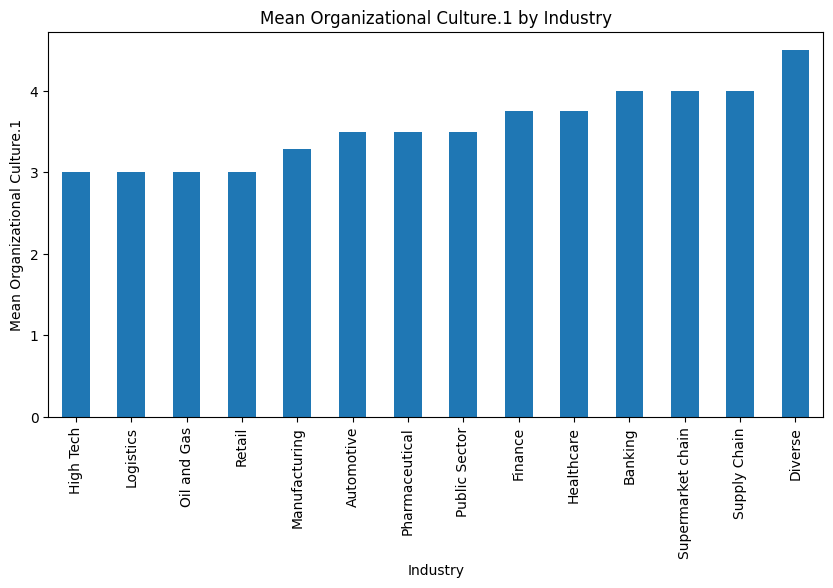

...

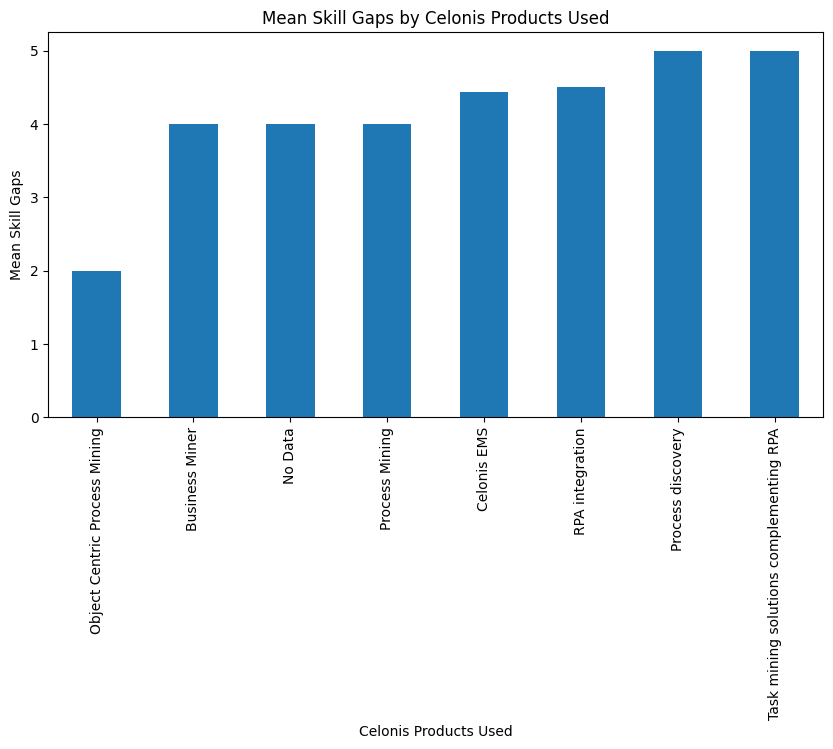

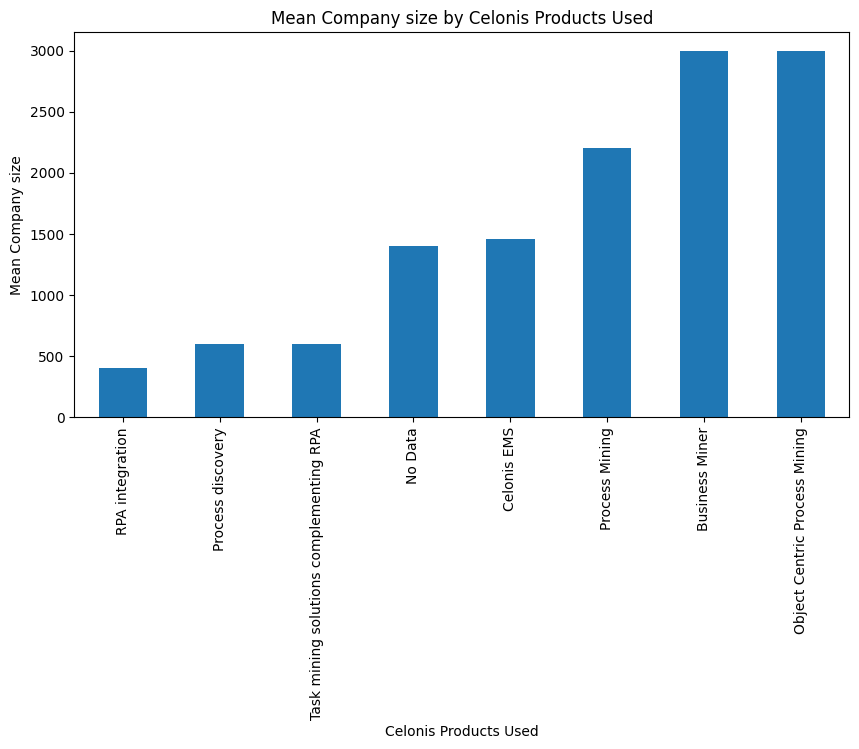

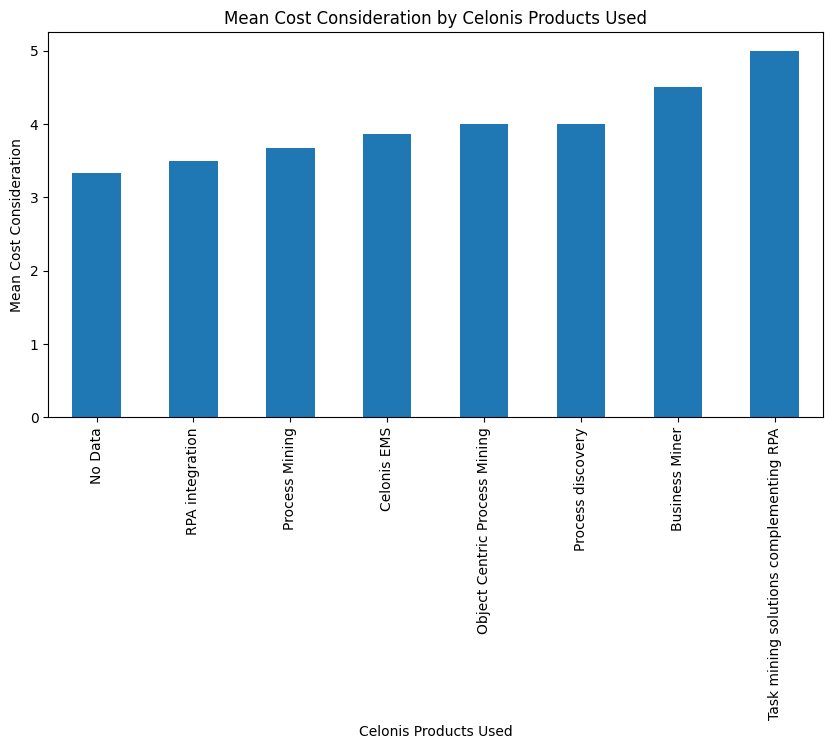

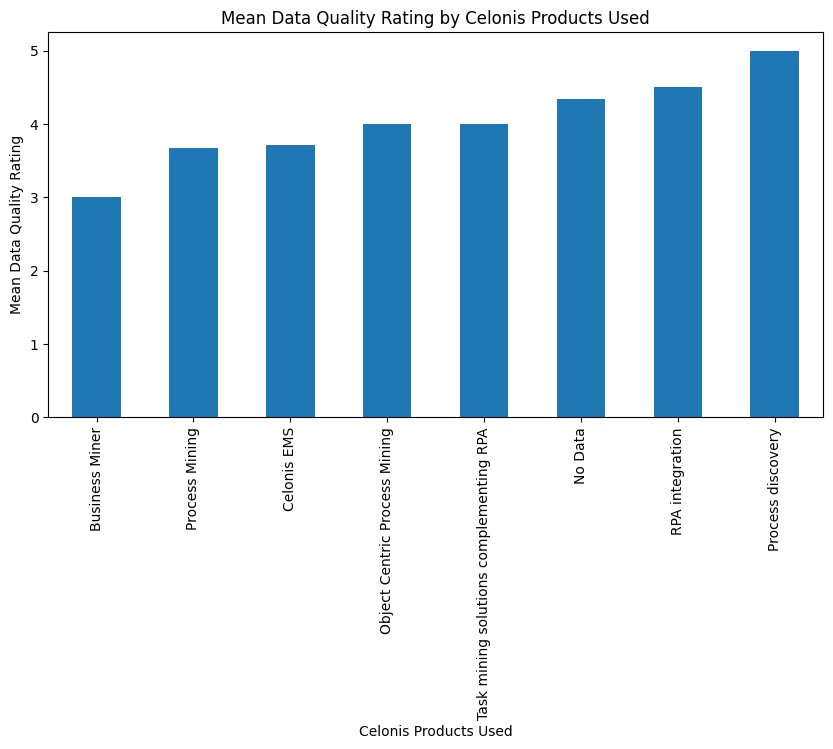

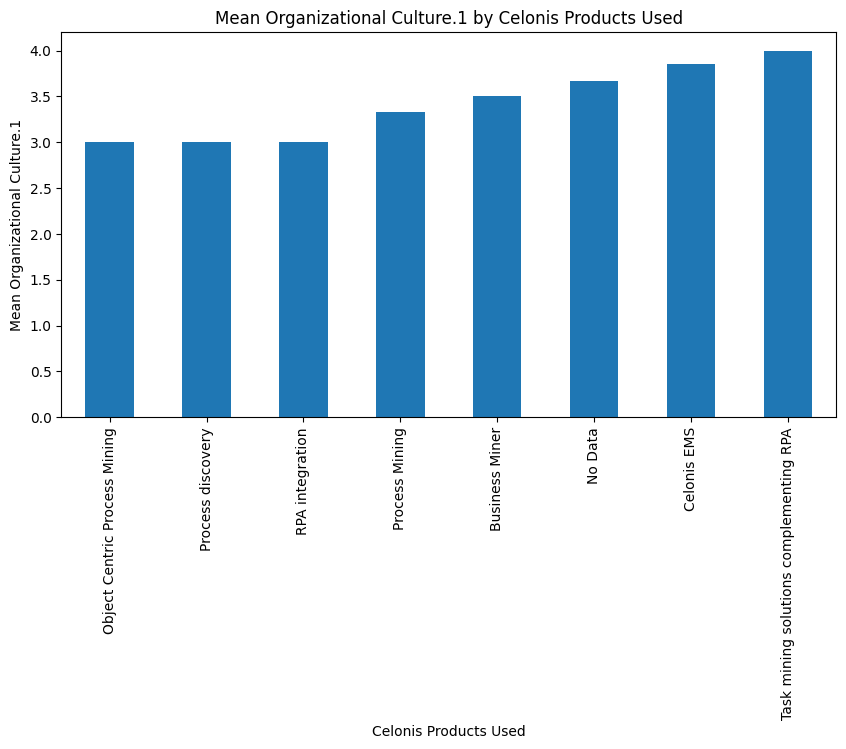

In [14]:
# Call the function for the bivariate categorical analysis
bivariate_categorical_analysis(
    data_implemeters,
    multicategory_columns_implementers,
    numerical_columns_implementers
)

### Bivariate Analysis for Implementers: analyze the relationship between pairs of numerical variables

In [15]:
def visualize_numerical_relationships(df, numerical_columns):
    # Correlation matrix
    plt.figure(figsize=(12, 8))
    correlation = df[numerical_columns].corr()
    sns.heatmap(correlation, annot=True, fmt=".2f", cmap='coolwarm')
    plt.title('Correlation Heatmap for Numerical Variables')
    plt.show()


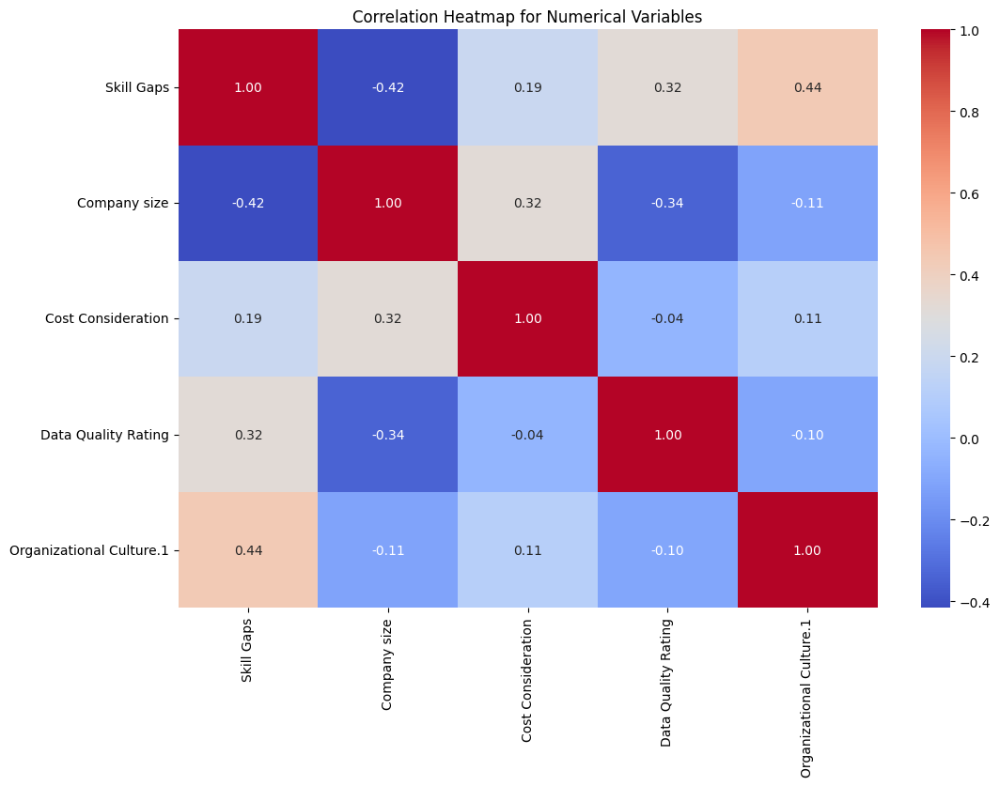

In [16]:
visualize_numerical_relationships(data_implemeters, numerical_columns_implementers)


### Bivariate Analysis for Implementers Categorical: analyze relationships between pairs of categorical variables

In [17]:
def visualize_categorical_relationships(df, multicategory_columns):
    # We need to first explode the multicategory columns
    for col1 in multicategory_columns:
        for col2 in multicategory_columns:
            if col1 != col2:
                # Explode both columns
                exploded_df = explode_multicategory(df, col1)
                exploded_df = explode_multicategory(exploded_df, col2)

                # Drop NaN values in both columns to ensure clean crosstab
                clean_df = exploded_df.dropna(subset=[col1, col2])

                # Normalize the whitespace and case
                clean_df[col1] = clean_df[col1].str.strip().str.lower()
                clean_df[col2] = clean_df[col2].str.strip().str.lower()

                # Create a crosstab to count occurrences
                crosstab = pd.crosstab(clean_df[col1], clean_df[col2])

                # Stacked bar chart
                crosstab.plot(kind='bar', stacked=True, figsize=(10, 6))
                plt.title(f'Stacked Bar Chart of {col1} vs {col2}')
                plt.xlabel(col1)
                plt.ylabel('Counts')
                plt.xticks(rotation=90)
                plt.legend(title=col2, bbox_to_anchor=(1.05, 1), loc='upper left')
                plt.tight_layout()
                plt.show()


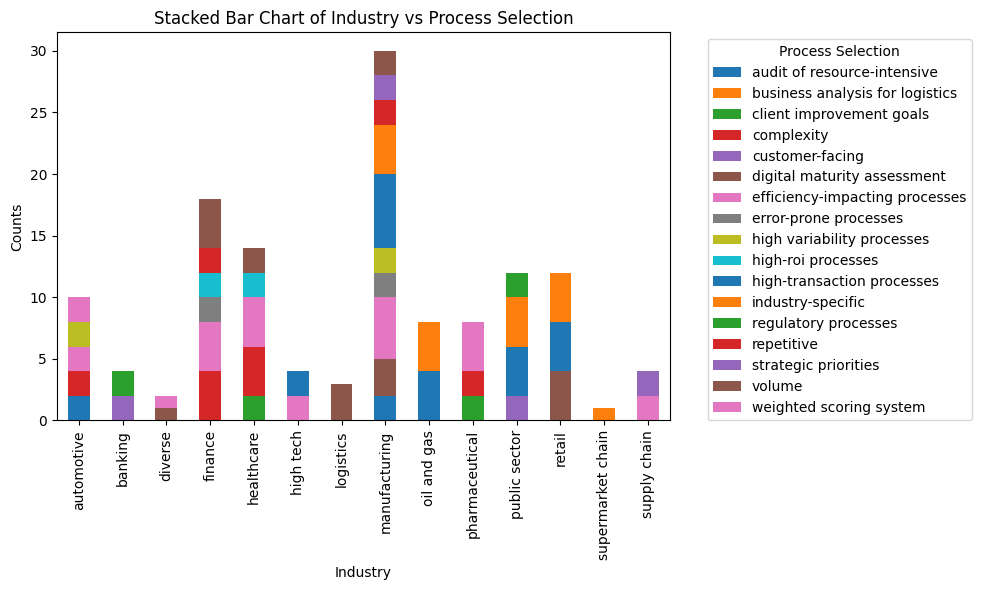

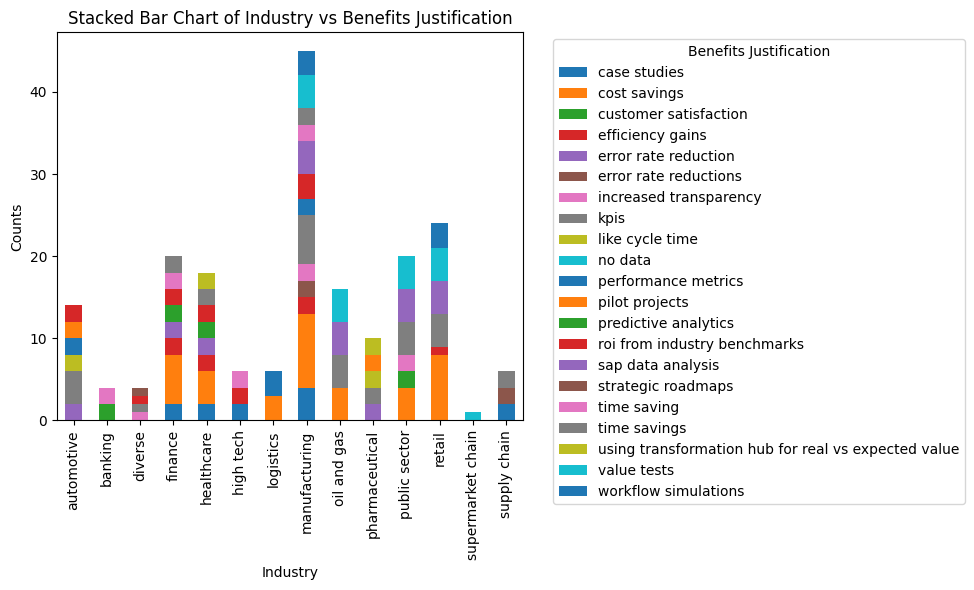

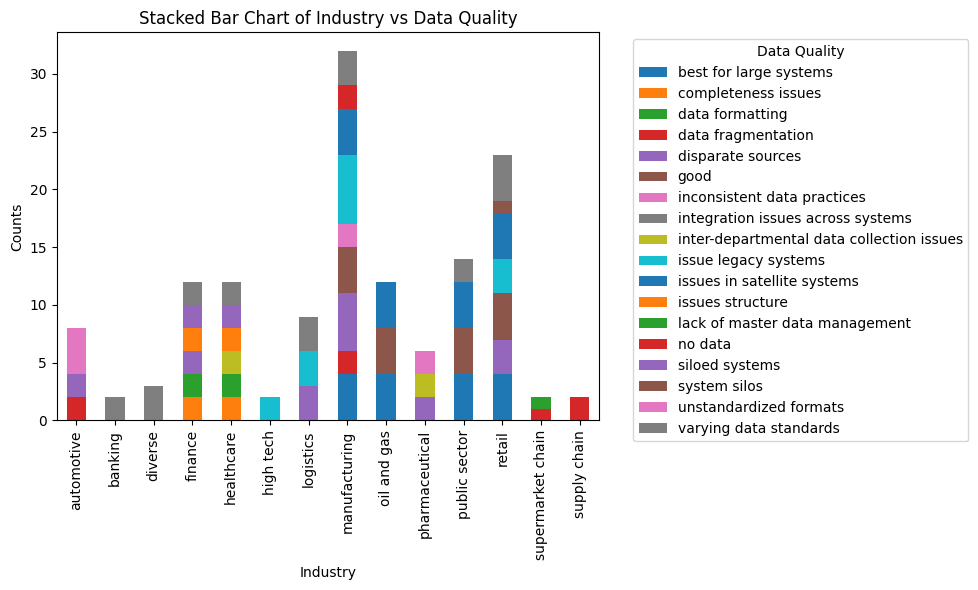

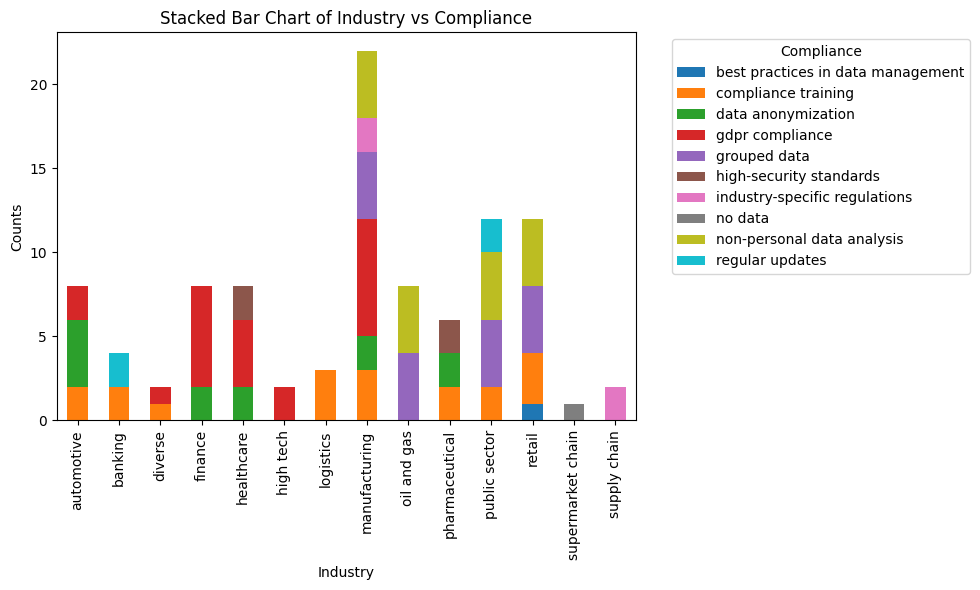

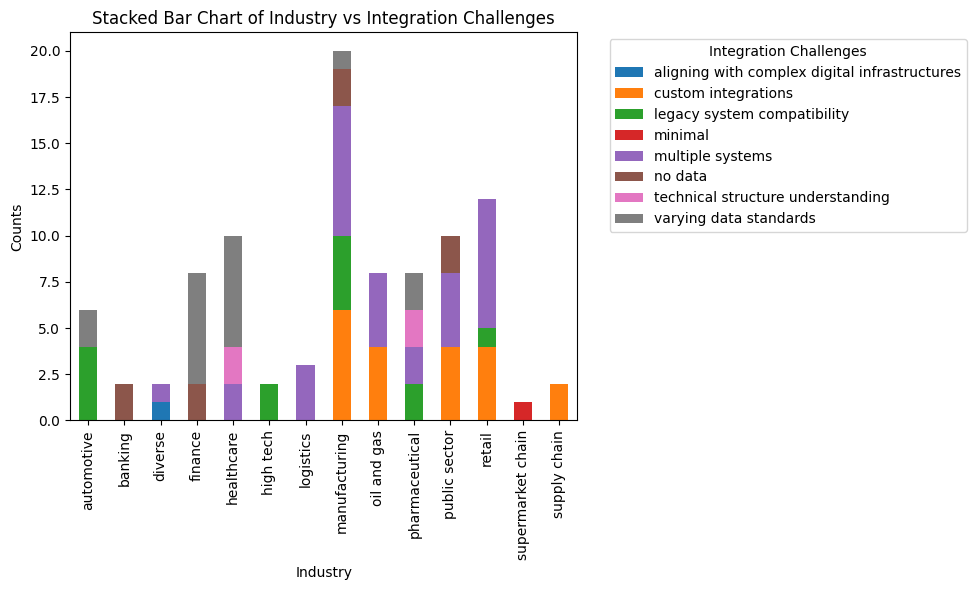

...

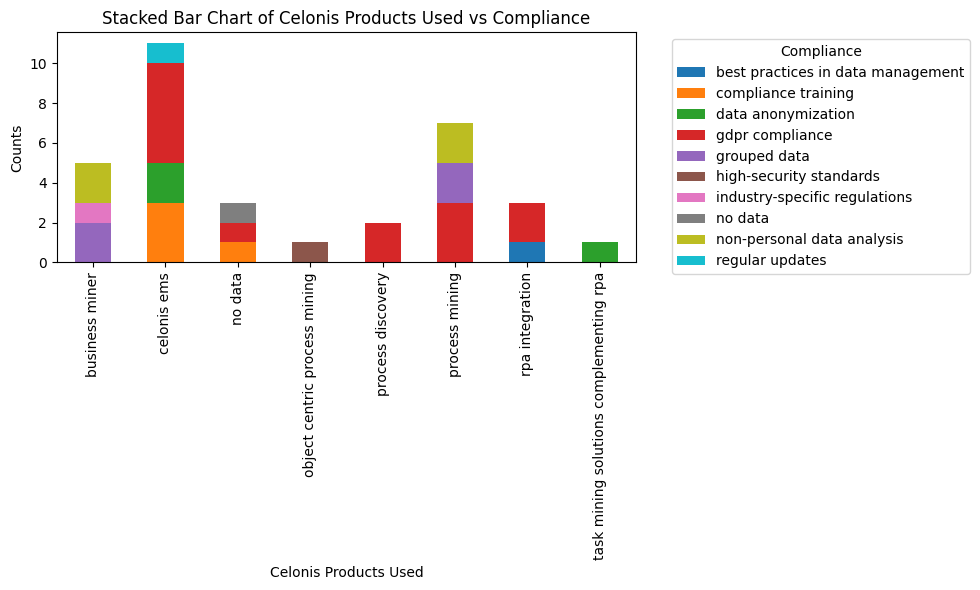

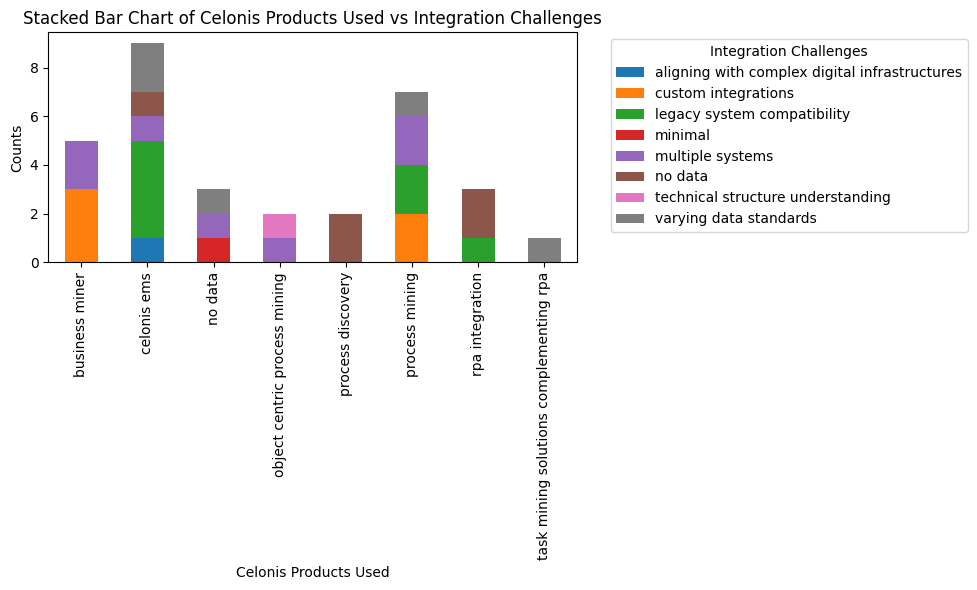

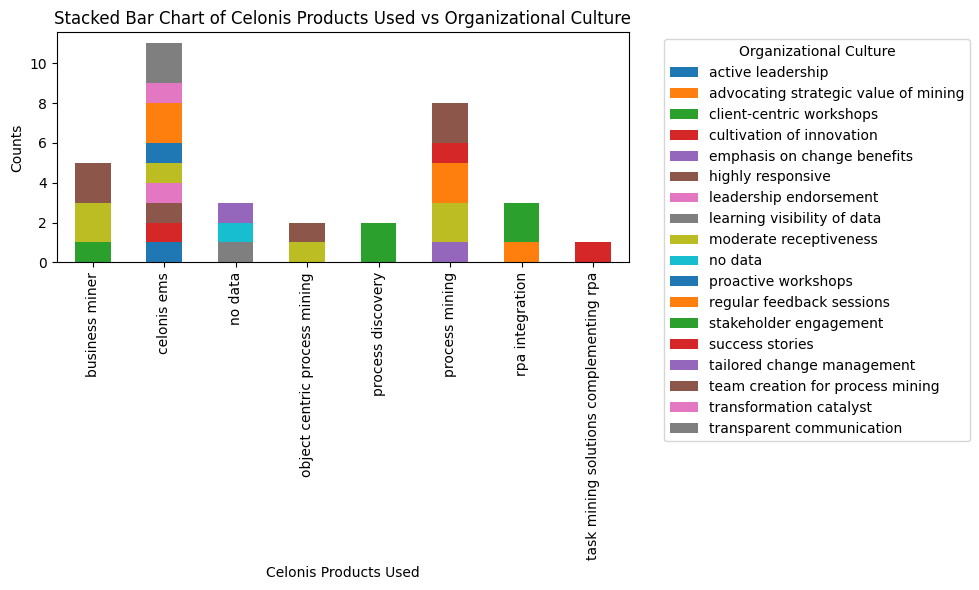

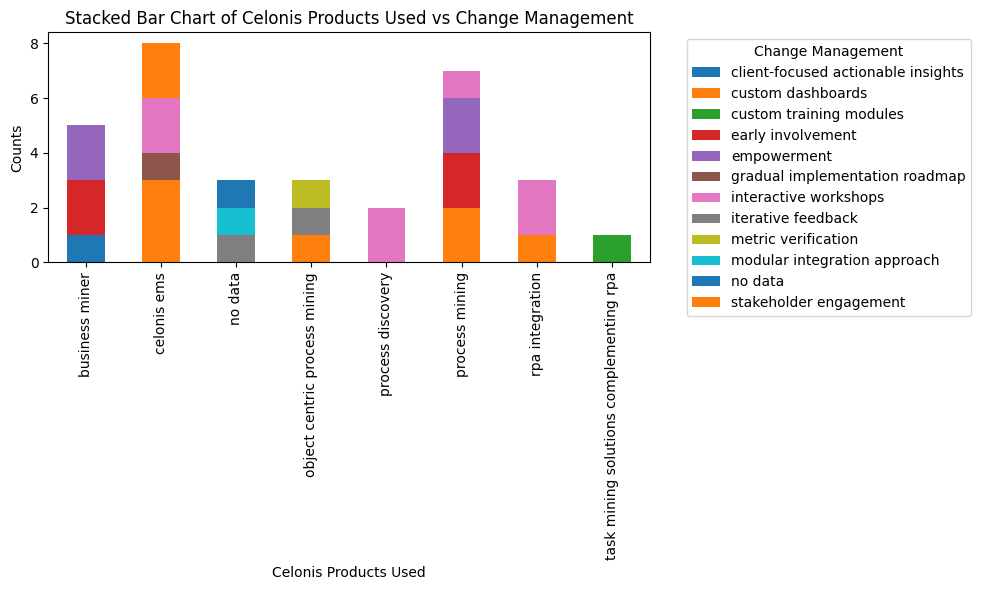

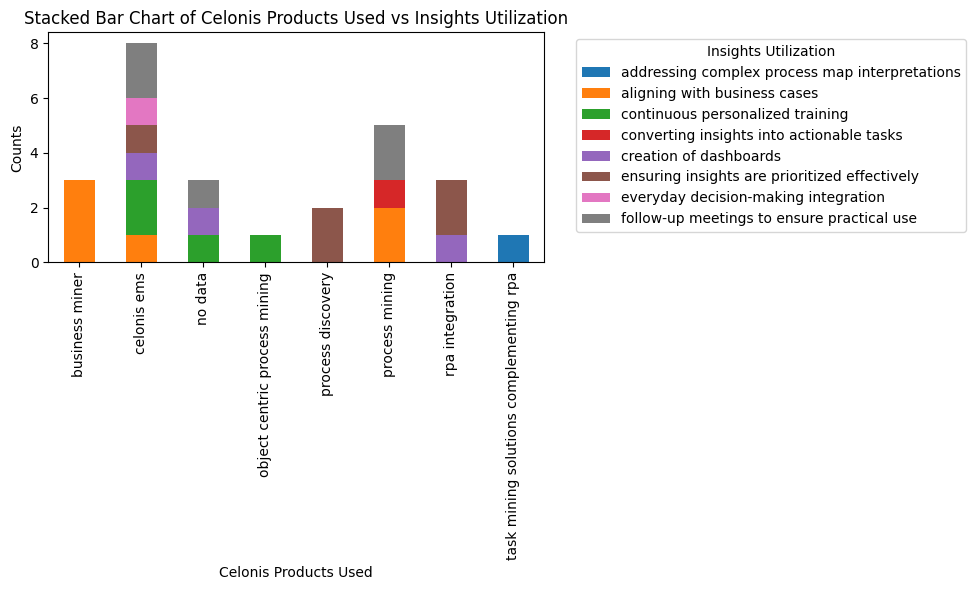

In [18]:
visualize_categorical_relationships(data_implemeters, multicategory_columns_implementers)


In [19]:
# Helper function to explode multicategory columns into a normalized form
def explode_multicategory(df, col):
    """Helper function to explode multicategory columns into a normalized form."""
    return (
        df.drop(col, axis=1)
        .join(
            df[col]
            .str.split(',', expand=True)
            .stack()
            .reset_index(level=1, drop=True)
            .rename(col)
        )
    )

In [20]:
multicategory_columns_users = ['Industry',	'Usage Frequency'	,'Role Utilization',	'Skill Gaps',	'Training Provided',	'Improvement Example',	'Suggestions', 'System Integration',	'Cultural Impact',	'Beneficial Features',	'Feedback']
numerical_columns_users = ['Company size', 'Impact']


### Bivariate Analysis for Users Categorical and Numerical: analyze relationships between pairs of categorical and numerical variables

In [21]:
def bivariate_categorical_analysis(df, multicategory_columns, numerical_columns):
    for col in multicategory_columns:
        exploded_df = explode_multicategory(df, col).dropna(subset=[col])
        exploded_df[col] = exploded_df[col].str.strip()

        for num_col in numerical_columns:
            # Calculate the mean of the numerical columns for each category
            means = exploded_df.groupby(col)[num_col].mean().sort_values()
            means.plot(kind='bar', figsize=(10, 5))
            plt.title(f'Mean {num_col} by {col}')
            plt.ylabel(f'Mean {num_col}')
            plt.xticks(rotation=90)
            plt.show()

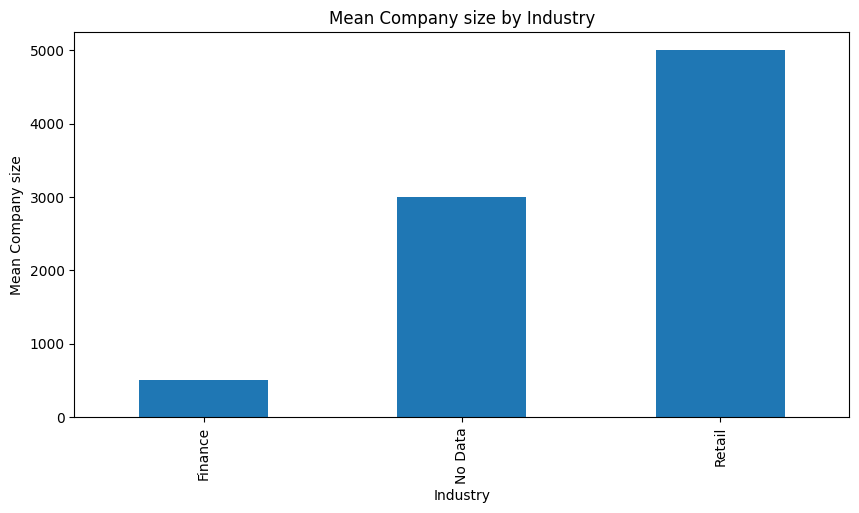

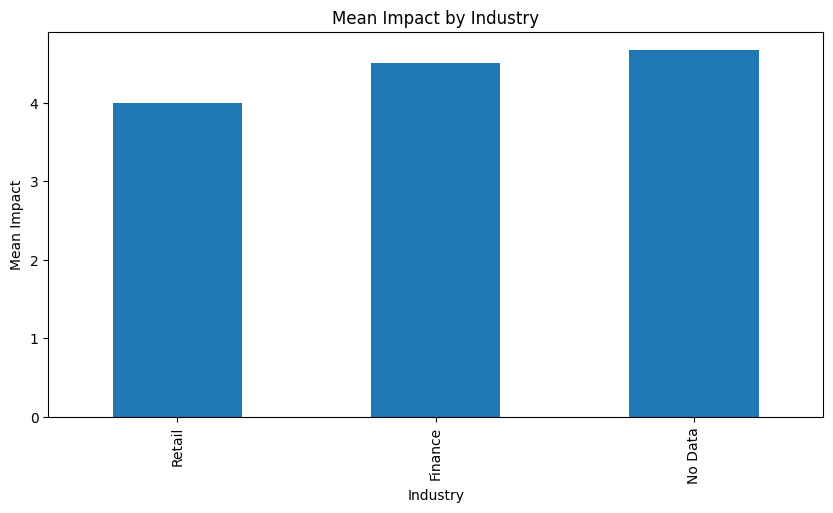

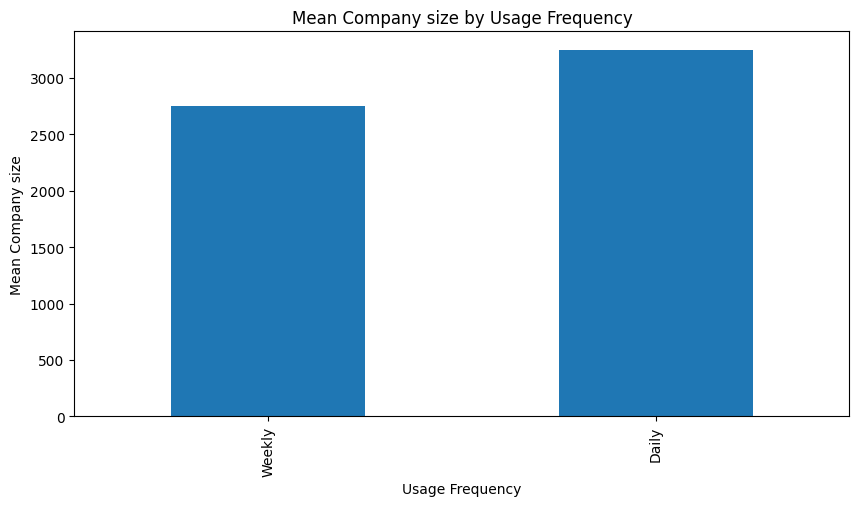

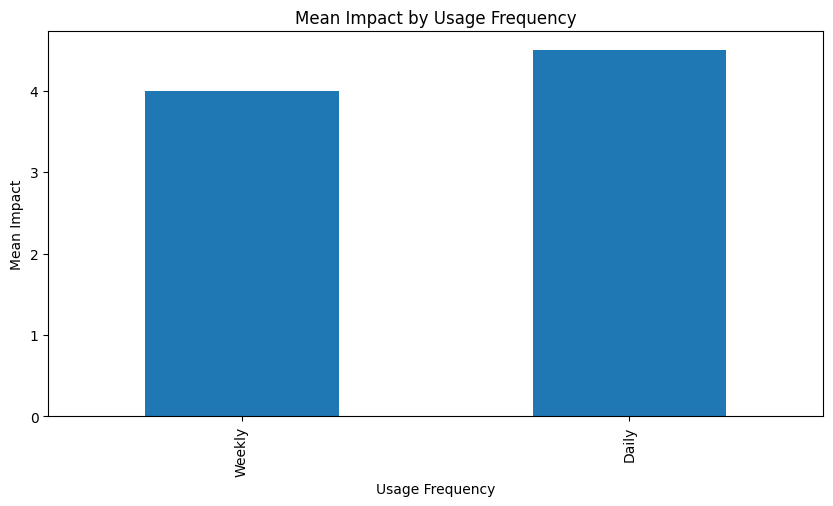

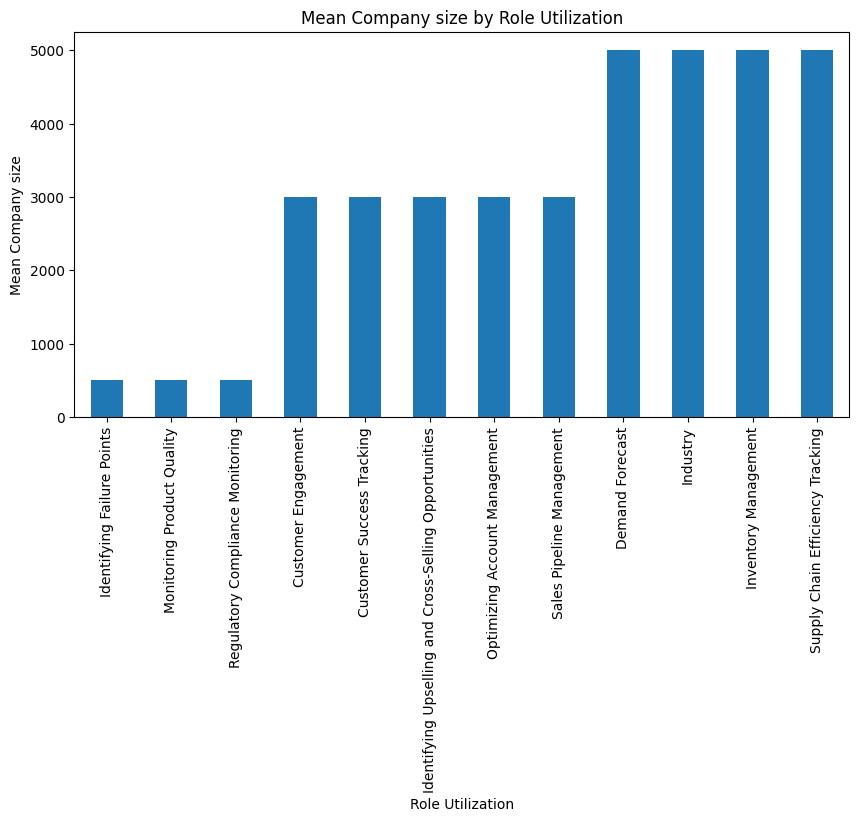

...

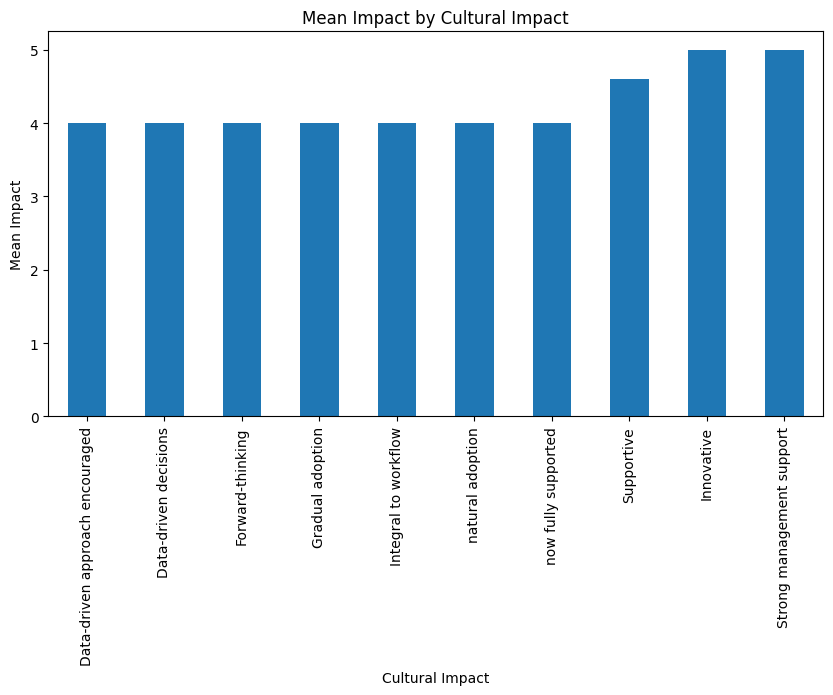

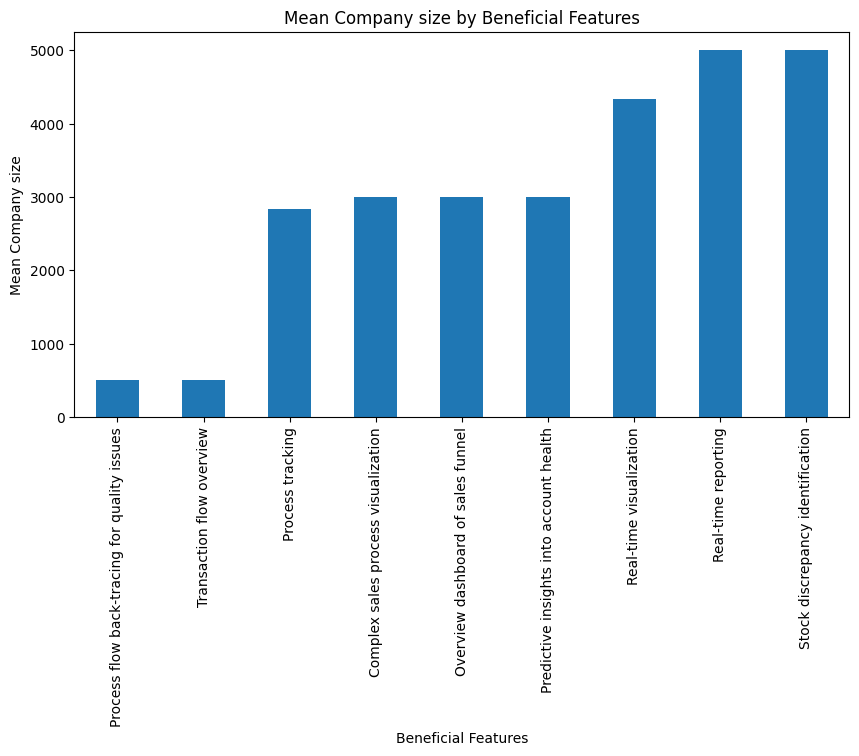

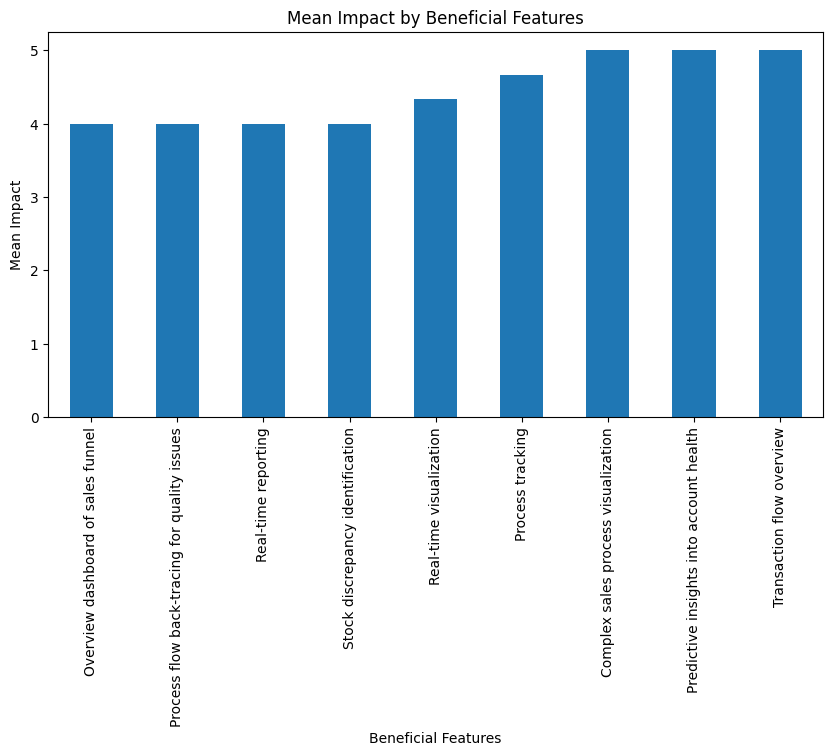

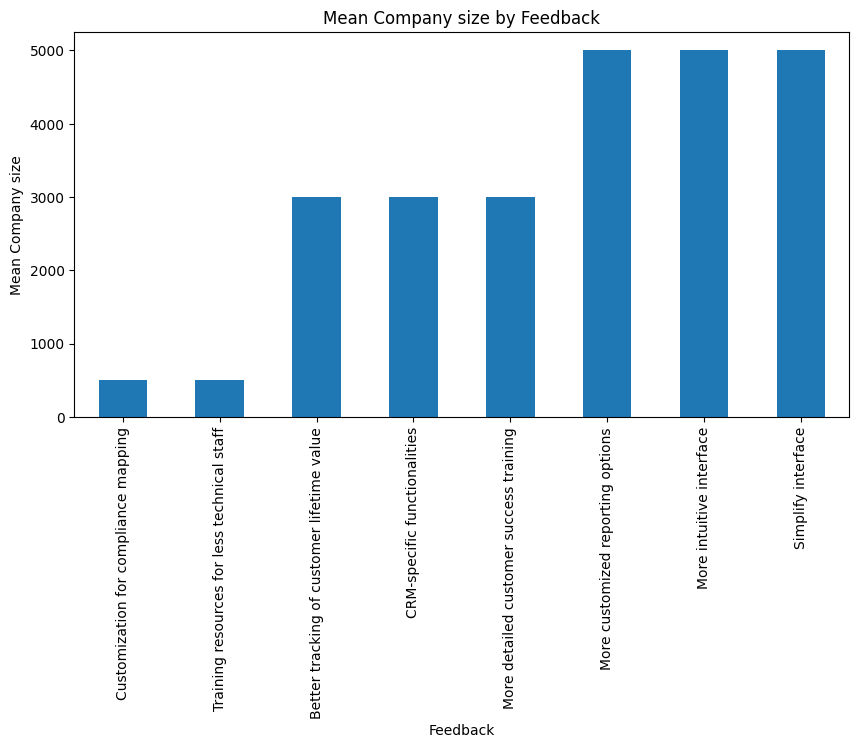

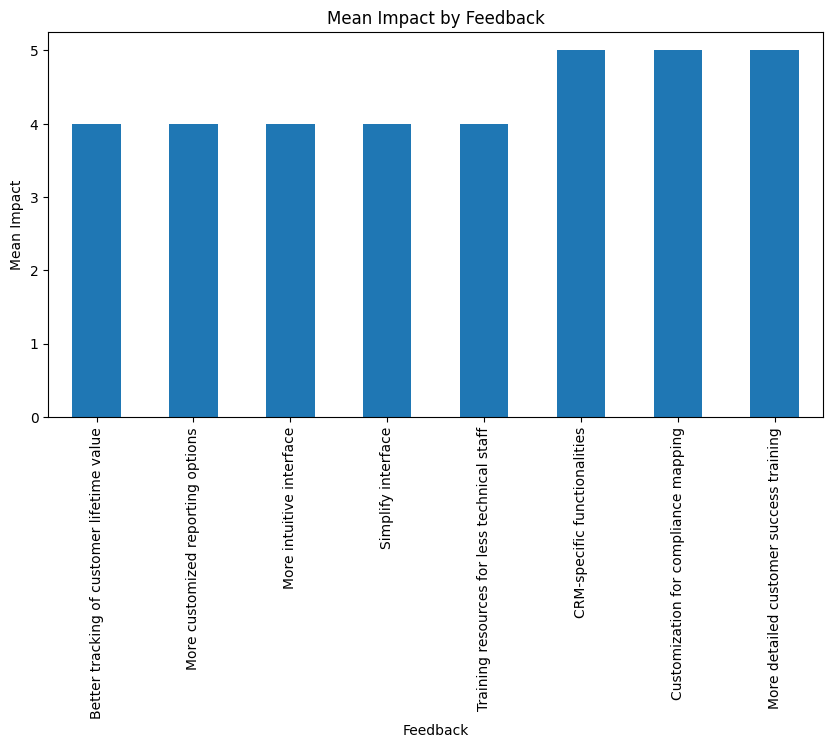

In [22]:
# Call the function for the bivariate categorical analysis
bivariate_categorical_analysis(
    data_users,
    multicategory_columns_users,
    numerical_columns_users
)

### Bivariate Analysis for Users: analyze the relationship between pairs of numerical variables

In [23]:
def visualize_numerical_relationships(df, numerical_columns):
    # Correlation matrix
    plt.figure(figsize=(12, 8))
    correlation = df[numerical_columns].corr()
    sns.heatmap(correlation, annot=True, fmt=".2f", cmap='coolwarm')
    plt.title('Correlation Heatmap for Numerical Variables')
    plt.show()

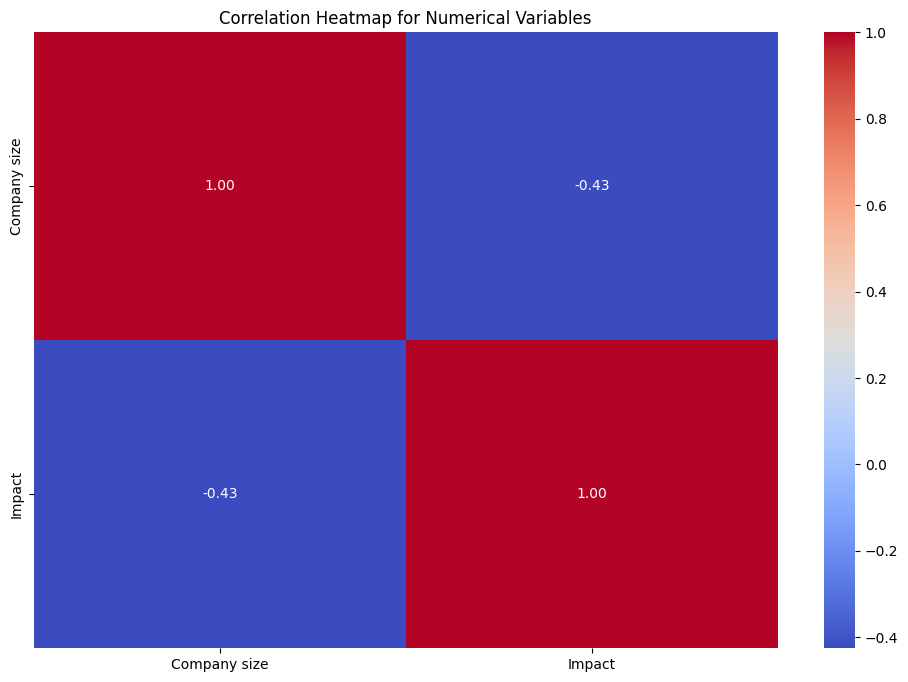

In [24]:
visualize_numerical_relationships(data_users, numerical_columns_users)

### Bivariate Analysis for Users Categorical: analyze relationships between pairs of categorical variables

In [25]:
def visualize_categorical_relationships(df, multicategory_columns):
    # We need to first explode the multicategory columns
    for col1 in multicategory_columns:
        for col2 in multicategory_columns:
            if col1 != col2:
                # Explode both columns
                exploded_df = explode_multicategory(df, col1)
                exploded_df = explode_multicategory(exploded_df, col2)

                # Drop NaN values in both columns to ensure clean crosstab
                clean_df = exploded_df.dropna(subset=[col1, col2])

                # Normalize the whitespace and case
                clean_df[col1] = clean_df[col1].str.strip().str.lower()
                clean_df[col2] = clean_df[col2].str.strip().str.lower()

                # Create a crosstab to count occurrences
                crosstab = pd.crosstab(clean_df[col1], clean_df[col2])

                # Stacked bar chart
                crosstab.plot(kind='bar', stacked=True, figsize=(10, 6))
                plt.title(f'Stacked Bar Chart of {col1} vs {col2}')
                plt.xlabel(col1)
                plt.ylabel('Counts')
                plt.xticks(rotation=90)
                plt.legend(title=col2, bbox_to_anchor=(1.05, 1), loc='upper left')
                plt.tight_layout()
                plt.show()

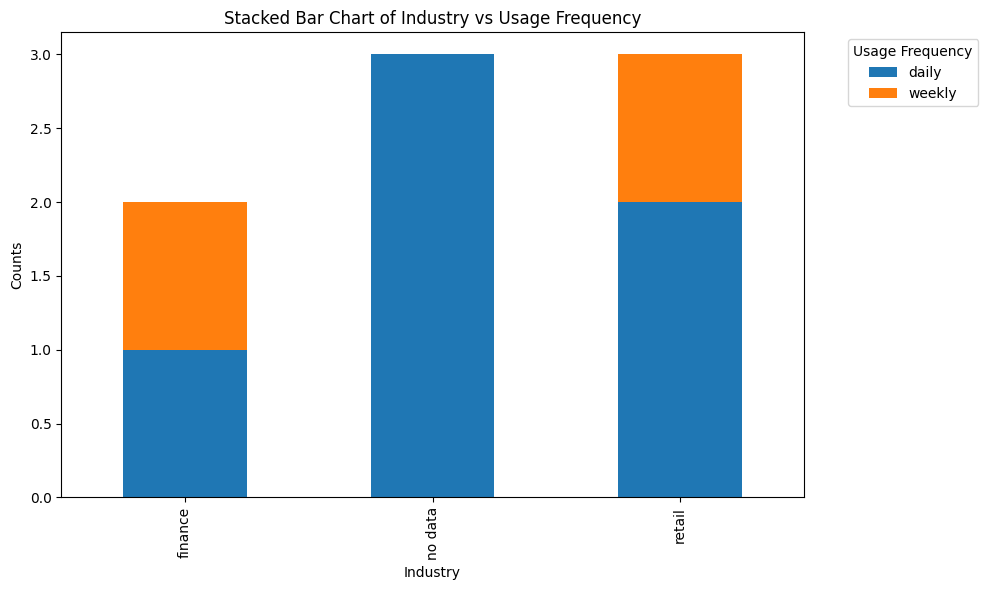

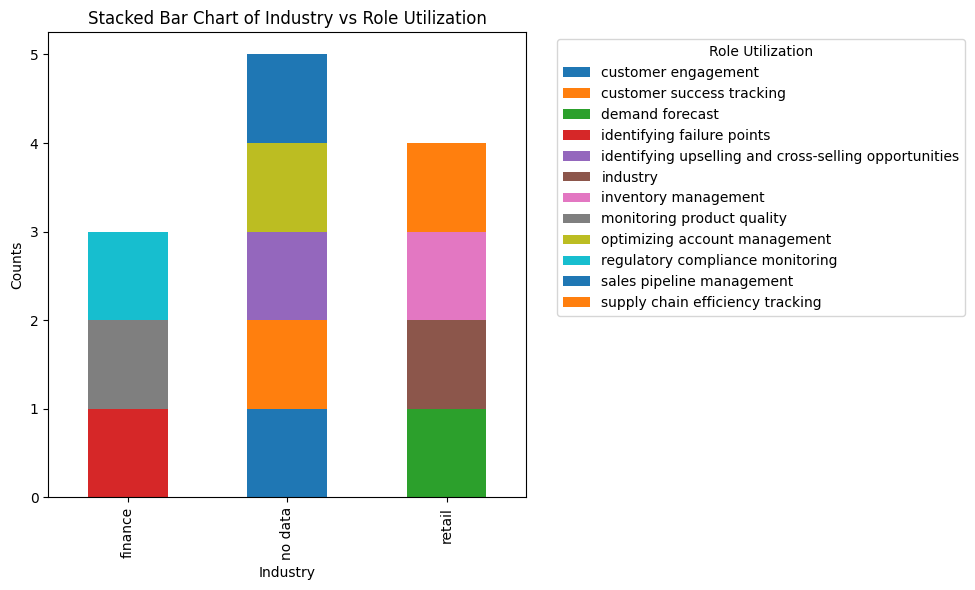

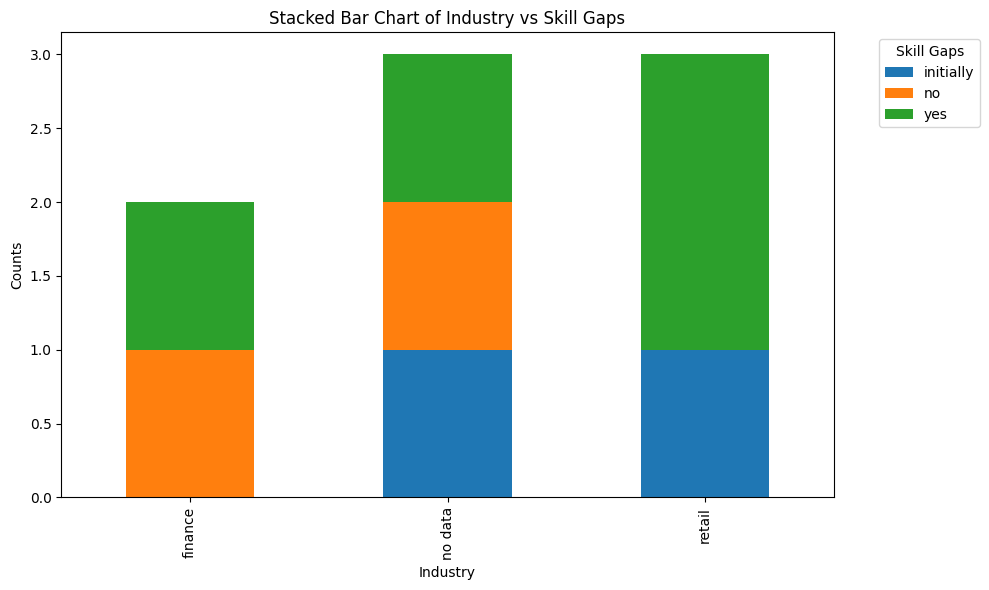

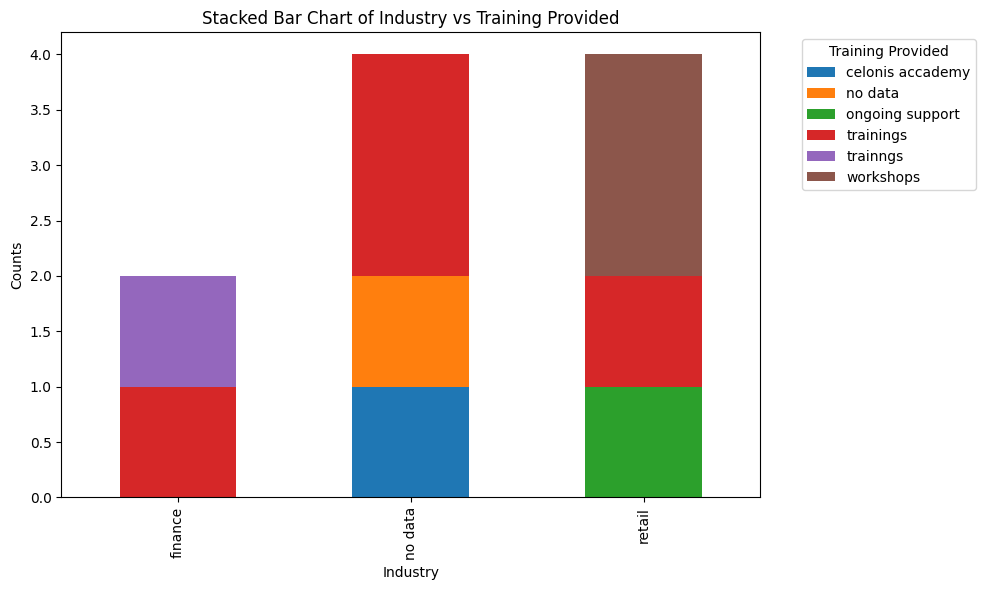

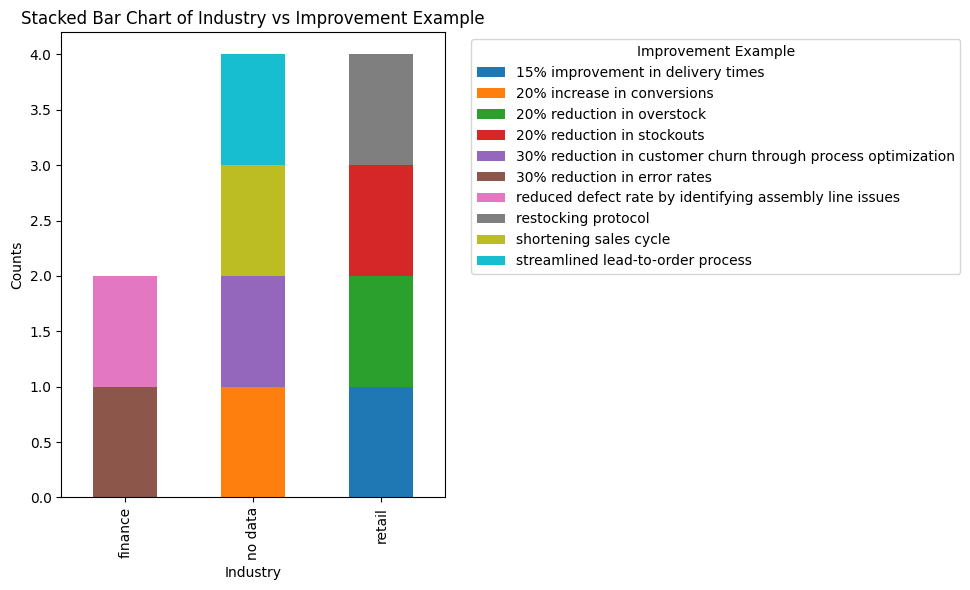

...

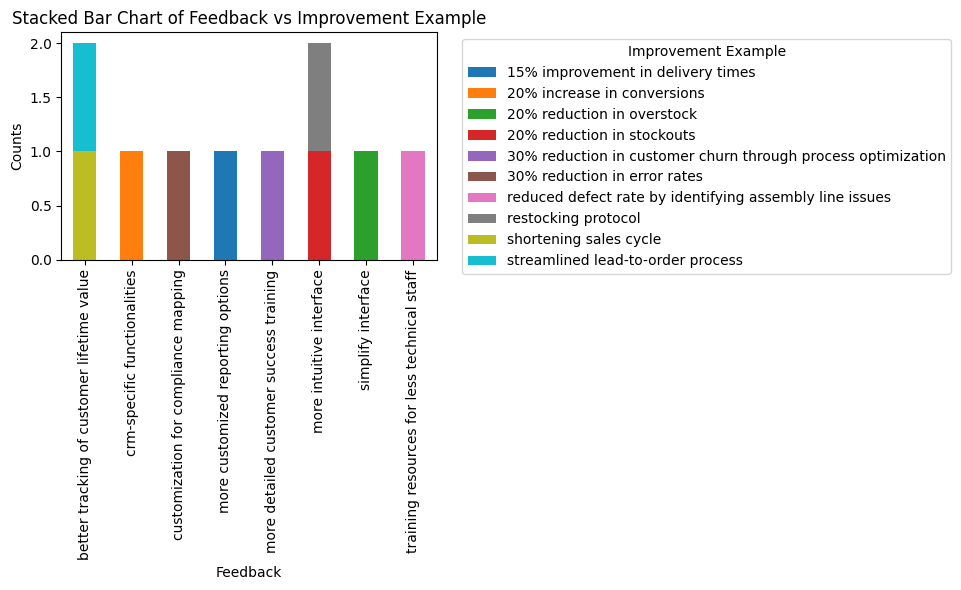

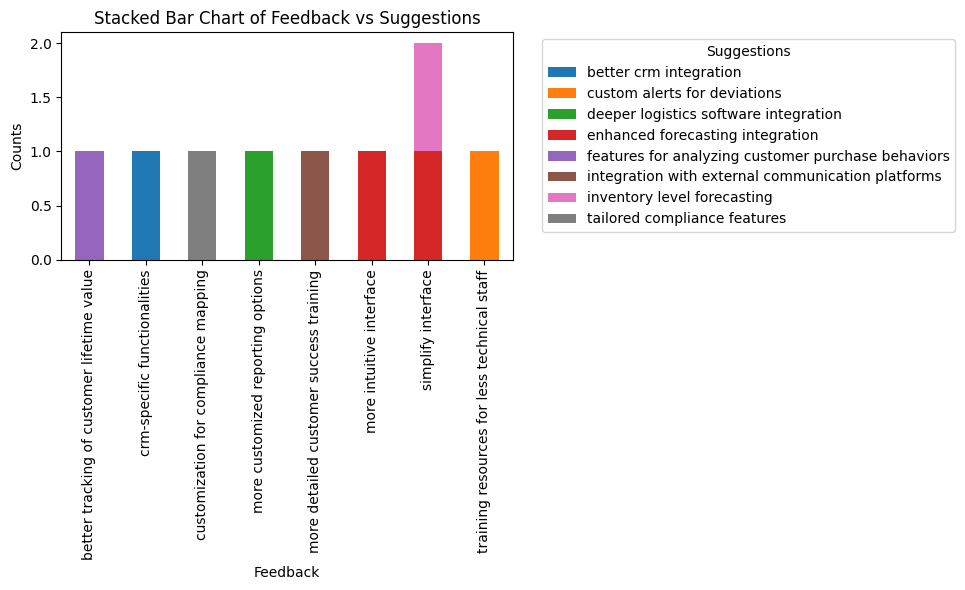

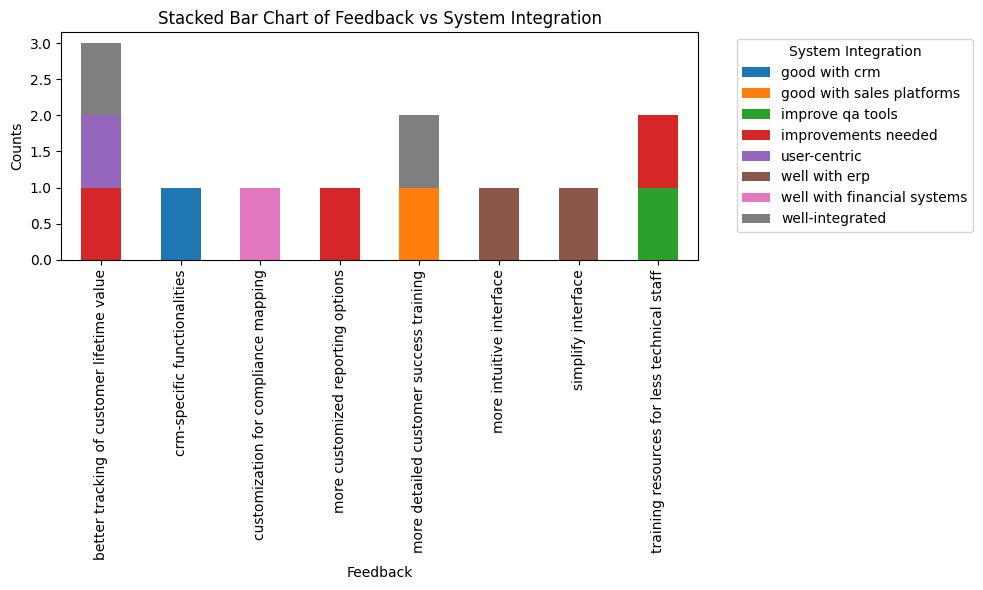

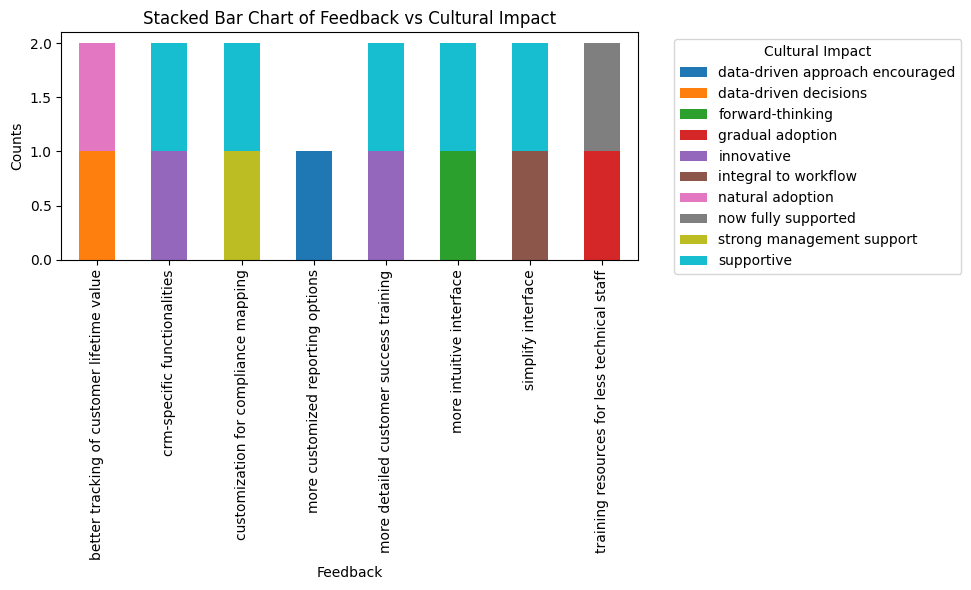

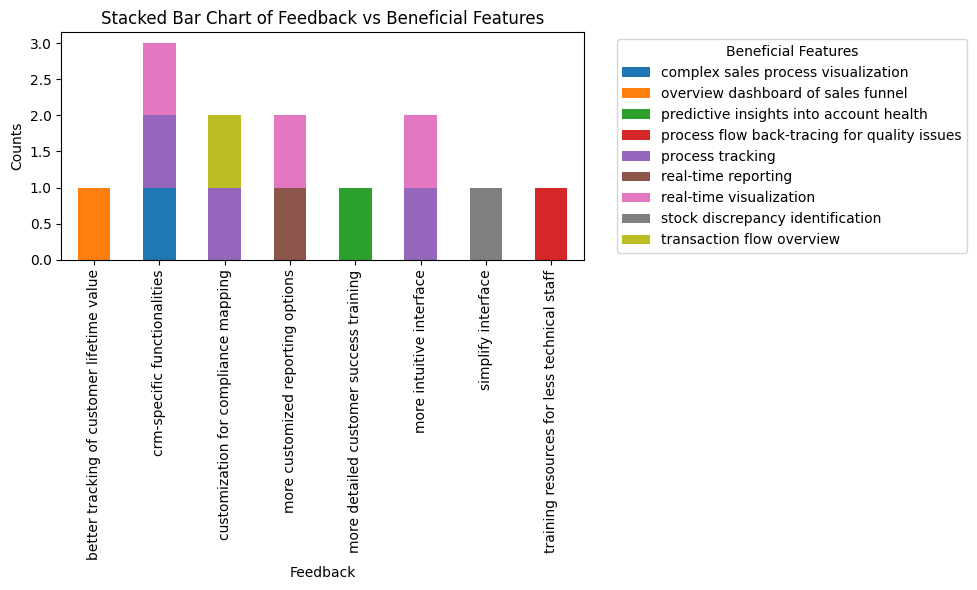

In [26]:
visualize_categorical_relationships(data_users, multicategory_columns_users)